In [1]:
using StatsBase, DataFrames, DataFrameMacros, MLJ
using RCall, CategoricalArrays, CSV
using MLJ: schema;

In [4]:
using Gadfly, Compose, ColorSchemes, Distributions
set_default_plot_size(15cm, 12cm)

In [5]:
include("pubh.jl")
@rimport readr
@rimport pubh
import GLM.@formula

## Data

The Western Collaborative Group Study (WCGS) is a well known prospective cohort study. Male participants aged 39 to 59 from 10 California companies were originally selected to study the relationship between behaviour pattern and the risk of coronary heart disease (CHD).

In [9]:
wcgs = readr.read_rds("data/wcgs.rds") |> rcopy
wcgs |> schema

┌──────────┬───────────────────────────────┬────────────────────────────────────
│ names    │ scitypes                      │ types                             ⋯
├──────────┼───────────────────────────────┼────────────────────────────────────
│ id       │ Count                         │ Int64                             ⋯
│ age      │ Count                         │ Int64                             ⋯
│ height   │ Continuous                    │ Float64                           ⋯
│ weight   │ Continuous                    │ Float64                           ⋯
│ sbp      │ Count                         │ Int64                             ⋯
│ dbp      │ Count                         │ Int64                             ⋯
│ chol     │ Union{Missing, Count}         │ Union{Missing, Int64}             ⋯
│ beh_pat  │ Multiclass{4}                 │ CategoricalValue{String, UInt32}  ⋯
│ ncigs    │ Count                         │ Int64                             ⋯
│ dib_pat  │ Multiclass{2}  

The `kfm` data frame was collected by Kim Fleischer Michaelsen and contains data for 50 infants of age approximately 2 months. They were weighed immediately before and after each breast feeding. and the measured intake of breast milk was registered along with various other data.

In [8]:
kfm = readr.read_rds("data/kfm.rds") |> rcopy
kfm |> schema

┌────────────┬───────────────┬──────────────────────────────────┐
│ names      │ scitypes      │ types                            │
├────────────┼───────────────┼──────────────────────────────────┤
│ no         │ Count         │ Int64                            │
│ dl_milk    │ Continuous    │ Float64                          │
│ sex        │ Multiclass{2} │ CategoricalValue{String, UInt32} │
│ weight     │ Continuous    │ Float64                          │
│ ml_suppl   │ Count         │ Int64                            │
│ mat_weight │ Count         │ Int64                            │
│ mat_height │ Count         │ Int64                            │
└────────────┴───────────────┴──────────────────────────────────┘


Data on reported cases of influenza by age group in the 1957 pandemic in England and Wales.

In [10]:
flu = DataFrame(CSV.File("data/fluraw.csv"))
flu |> schema

┌───────┬────────────────┬───────┐
│ names │ scitypes       │ types │
├───────┼────────────────┼───────┤
│ week  │ ScientificDate │ Date  │
│ child │ Count          │ Int64 │
│ young │ Count          │ Int64 │
│ mid   │ Count          │ Int64 │
│ old   │ Count          │ Int64 │
└───────┴────────────────┴───────┘


Data on birth weights from newborns in a London Hospital.

In [11]:
birth = readr.read_rds("data/birthwt.rds") |> rcopy
birth |> schema

┌───────┬───────────────┬──────────────────────────────────┐
│ names │ scitypes      │ types                            │
├───────┼───────────────┼──────────────────────────────────┤
│ low   │ Multiclass{2} │ CategoricalValue{String, UInt32} │
│ age   │ Count         │ Int64                            │
│ lwt   │ Continuous    │ Float64                          │
│ race  │ Multiclass{3} │ CategoricalValue{String, UInt32} │
│ smoke │ Multiclass{2} │ CategoricalValue{String, UInt32} │
│ ptl   │ Count         │ Int64                            │
│ ht    │ Multiclass{2} │ CategoricalValue{String, UInt32} │
│ ui    │ Multiclass{2} │ CategoricalValue{String, UInt32} │
│ ftv   │ Count         │ Int64                            │
│ bwt   │ Count         │ Int64                            │
│ Race  │ Multiclass{2} │ CategoricalValue{String, UInt32} │
└───────┴───────────────┴──────────────────────────────────┘


Data on the energy expenditure in groups of lean and obese women.

In [12]:
energy = rcopy(R"ISwR::energy")
energy |> schema

┌─────────┬───────────────┬──────────────────────────────────┐
│ names   │ scitypes      │ types                            │
├─────────┼───────────────┼──────────────────────────────────┤
│ expend  │ Continuous    │ Float64                          │
│ stature │ Multiclass{2} │ CategoricalValue{String, UInt32} │
└─────────┴───────────────┴──────────────────────────────────┘


Fisher's iris dataset on measurements for three species of iris.

In [13]:
iris = rcopy(R"datasets::iris")
iris |> schema

┌──────────────┬───────────────┬──────────────────────────────────┐
│ names        │ scitypes      │ types                            │
├──────────────┼───────────────┼──────────────────────────────────┤
│ Sepal_Length │ Continuous    │ Float64                          │
│ Sepal_Width  │ Continuous    │ Float64                          │
│ Petal_Length │ Continuous    │ Float64                          │
│ Petal_Width  │ Continuous    │ Float64                          │
│ Species      │ Multiclass{3} │ CategoricalValue{String, UInt32} │
└──────────────┴───────────────┴──────────────────────────────────┘


Data on air quality and weather conditions in New York, recorded May to September 1973.

In [14]:
air = rcopy(R"datasets::airquality") |> DF.dropmissing
air |> schema

UndefVarError: UndefVarError: `DF` not defined

## Distributions

### Histograms

We use histograms to look at the distribution of continuous variables. Histograms make most sense for relatively large data ($\geq 100$ observations). In this fist histogram, we show the density.

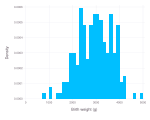

In [16]:
#| label: fig-fig1
#| fig-cap: "Distribution of birth weight from newborns in a London Hospital."
plot(
	birth,
	x = :bwt, Guide.xlabel("Birth weight (g)"),
	Guide.ylabel("Density"),
	Geom.histogram(bincount=30, density=true)
)

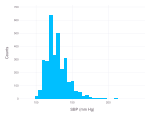

In [17]:
#| label: fig-fig2
#| fig-cap: "Distribution of systolic blood pressure (SBP) from subjects in the WCGS dataset."
plot(
	wcgs,
	x = :sbp, 
	Geom.histogram(bincount=30),
	Guide.xlabel("SBP (mm Hg)"),
	Guide.ylabel("Counts"),
	Coord.cartesian(xmin=80, ymax=700)
)

We can compare distributions using the density or the probability density function (pdf), as shown here:

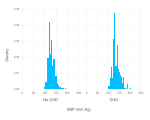

In [18]:
#| label: fig-fig4
#| fig-cap: "Comparison of systolic blood pressure (SBP) distributions by coronary heart disease (CHD) events."
plot(
	wcgs,
	x = :sbp, xgroup = :chd,
	Geom.subplot_grid(Geom.histogram(bincount=30, density=true)),
	Guide.xlabel("SBP (mm Hg)"),
	Guide.ylabel("Density")
)

### Density Plots

Another way to look at the distribution of a continuous variable is with density plots.

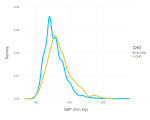

In [19]:
#| label: fig-fig5
#| fig-cap: "Distribution of systolic blood pressure (SBP) by coronary heart disease (CHD) event."
plot(
	wcgs,
	x = :sbp, color = :chd,
	Geom.density,
	Guide.xlabel("SBP (mm Hg)"),
	Guide.ylabel("Density"),
	Guide.colorkey(title="CHD"),
	style(line_width=1mm),
	Coord.cartesian(xmin=80)
)

:::{.callout-tip}
We have missing values in `chol`, thus we need to drop them before constructing a density plot or else, we would have an error.
:::

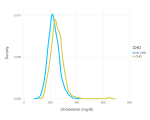

In [20]:
#| label: fig-fig7
#| fig-cap: "Distribution of blood cholesterol by coronary heart disease (CHD) event from the WCGS dataset."
plot(
	@subset(wcgs, !ismissing(:chol)),
	x = :chol, color = :chd,
	Geom.density,
	Guide.xlabel("Cholesterol (mg/dl)"),
	Guide.ylabel("Density"),
	Guide.colorkey(title="CHD"),
	style(line_width=1mm),
	Coord.cartesian(ymax=0.011)
)

### QQ-Plots

The best way to determine if a continuous variable is normally distributed or not is with quantile-quantile plots (QQ-plots). We plot the quantiles of our variable of interest against quantiles from the standard normal distribution (which has a mean $\mu=0$ and a standard deviation $\sigma=1$). This type of QQ-plots against the normal distribution are known as QQ-normal plots. If the variable is normally distributed, then a linear relationship will be observed.

:::{.callout-important}
By default, `QQNorm` uses the name of the variable as title for the $x$-axis, whih is wrong! We define the titles of the plot in `draw`.
:::

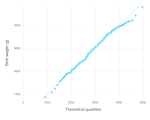

In [21]:
#| label: fig-fig8
#| fig-cap: "QQ-plot of birth weights from newborns in a London hospital."
let
	yeqx(x=800:5000) = layer(x=x, Geom.abline(color="gray80"))
	
	plot(
		birth,
		x=fit.([Normal], [birth.bwt]), y=:bwt,
		Stat.qq, yeqx,
		Guide.xlabel("Theoretical quantiles"),
		Guide.ylabel("Birth weight (g)"),
		Coord.cartesian(ymin=800)
	)
end

Right-skewed variables, show an upper right curve in the QQ-plot:

In [22]:
#| label: fig-fig9
#| fig-cap: "QQ-plot of diastolic blood pressure (DBP) in subjects from the WCGS dataset."
let
	yeqx(x = 40:120) = layer(x=x, Geom.abline(color="gray80"))
	
	plot(
		wcgs,
		x=fit.([Normal], [wcgs.dbp]), y=:dbp,
		Stat.qq, yeqx,
		Guide.xlabel("Theoretical quantiles"),
		Guide.ylabel("DBP (mm Hg)"),
		Coord.cartesian(ymin=40)
	)
end

The next two plots, shows the use of log scales.

In [23]:
#| label: fig-fig10
#| fig-cap: "QQ-plot of diastolic blood pressure (DBP) in subjects from the WCGS dataset."
plot(
	wcgs,
	x=fit.([Normal], [wcgs.dbp]), y=:dbp,
	Stat.qq,
	Guide.xlabel("Theoretical quantiles"),
	Guide.ylabel("DBP (mm Hg)"),
	Scale.y_log10
	)

## Associations Between Continuous Variables

### Scatter Plots

We use scatter plots to look at the relationship between two continuous variables. By default, the dependent variable (response) is plotted on the $y$-axis while the independent variable (explanatory) is plotted on the $x$-axis.

From the `kfm` dataset, let’s see if there is a relationship between the weight of the mother and the breast-milk intake of the child.

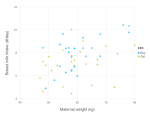

In [24]:
#| label: fig-fig12
#| fig-cap: "Relationship between maternal weight and breast-milk intake in infants."
plot(
	kfm,
	x = :mat_weight, y = :dl_milk, color = :sex,
	Guide.xlabel("Maternal weight (kg)"),
	Guide.ylabel("Breast milk intake (dl/day) ")
)

:::{.callout-note}
We can extend plots by adding new *layers*. In the following example, we use two layers: one for the scatter plot and a second to add a line representing a linear fit.
:::

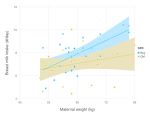

In [25]:
#| label: fig-fig13
#| fig-cap: "Relationship between maternal weight and breast-milk intake in infants."
plot(
	kfm,
	x = :mat_weight, y = :dl_milk, color = :sex,
	Geom.point, 
	layer(Stat.smooth(method=:lm), Geom.line, Geom.ribbon),
	Guide.xlabel("Maternal weight (kg)"),
	Guide.ylabel("Breast milk intake (dl/day) ")
)

In the next plot, instead of showing the linear fit, we add a loess trend with a smoother:

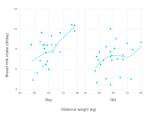

In [26]:
#| label: fig-fig14
#| fig-cap: "Relationship between maternal weight and breast-milk intake in infants."
plot(
	kfm,
	x = :mat_weight, y = :dl_milk, xgroup = :sex,
	Geom.subplot_grid(Geom.point, Geom.smooth(smoothing=0.9)),
	Guide.xlabel("Maternal weight (kg)"),
	Guide.ylabel("Breast milk intake (dl/day) ")
)

In the next plot, we use different line colours and different symbols (by sex):

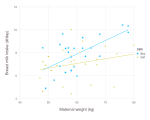

In [27]:
#| label: fig-fig15
#| fig-cap: "Relationship between maternal weight and breast-milk intake in infants."
plot(
	kfm,
	x = :mat_weight, y = :dl_milk, color = :sex, shape = :sex,
	Geom.point, Geom.smooth(method = :lm),
	Guide.xlabel("Maternal weight (kg)"),
	Guide.ylabel("Breast milk intake (dl/day) ")
)

### Line Charts

In this example, our dataset is in *wide* format.

Reshaping *wide* to *long* data:

In [29]:
flu |> head

Row,week,child,young,mid,old
,Date,Int64,Int64,Int64,Int64
1,1957-08-25,0,0,1,1
2,1957-09-01,0,2,6,1
3,1957-09-08,0,2,4,2
4,1957-09-15,23,73,63,11
5,1957-09-22,63,208,173,41


In [32]:
flu_melt = stack(flu, Not(:week)); flu_melt |> head

Row,week,variable,value
,Date,String,Int64
1,1957-08-25,child,0
2,1957-09-01,child,0
3,1957-09-08,child,0
4,1957-09-15,child,23
5,1957-09-22,child,63


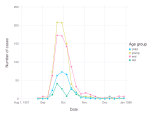

In [33]:
#| label: fig-fig22
#| fig-cap: "Dynamics of reported influenza cases by age group, in the 1957 pandemic in England and Wales."
#| warning: false
plot(
	flu_melt,
	x = :week, y = :value, color = :variable,
	Geom.point, Geom.path,
	Guide.xlabel("Date"),
	Guide.ylabel("Number of cases"),
	Guide.colorkey("Age group")
)

## Comparing Groups

### Box-Plots

When we are comparing continuous variables, between two or more groups, box plots are the best option, particularly if the number of observations in the groups is relatively large $(\geq 30)$.

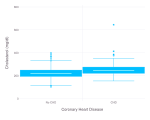

In [34]:
#| label: fig-fig23
#| fig-cap: "Box plots of blood cholesterol by coronary heart disease (CHD) event from the WCGS dataset."
plot(
	@subset(wcgs, !ismissing(:chol)),
	x = :chd, y = :chol,
	Geom.boxplot,
	Guide.xlabel("Coronary Heart Disease"),
	Guide.ylabel("Cholesterol (mg/dl)")
)

In the previous figure the presence of an outlier is clear. If we would like to remove that outlier, we would need to declare that in the report. For demonstration purposes, if we do not want to show the outlier in the plot, we have the option to *filter* the data using the `@subset` command.

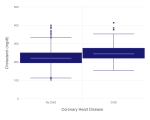

In [35]:
#| label: fig-fig24
#| fig-cap: "Box plots of blood cholesterol by coronary heart disease (CHD) event from the WCGS dataset. A single outlier from the CHD group with a cholesterol concentration of 645 mg/dl is not shown for group comparison purposes."
plot(
	@subset(wcgs |> dropmissing, :chol .< 500),
	x = :chd, y = :chol,
	Geom.boxplot,
	Guide.xlabel("Coronary Heart Disease"),
	Guide.ylabel("Cholesterol (mg/dl)"),
	Theme(default_color="MidnightBlue")
)

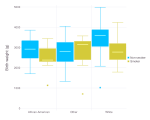

In [36]:
#| label: fig-fig25
#| fig-cap: "Comparison of birth weight distributions by ethnicity and smoking status of the mother."
plot(
	birth,
	x = :race, y = :bwt, color = :smoke,
	Geom.boxplot,
	Guide.xlabel(""),
	Guide.ylabel("Birth weight (g)"),
	Guide.colorkey("")
)

Faceting:

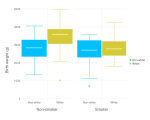

In [37]:
#| label: fig-fig26
#| fig-cap: "Comparison of birth weight distributions by ethnicity and smoking status of the mother."
plot(
	birth,
	x = :Race, y = :bwt, color=:Race, xgroup = :smoke,
	Geom.subplot_grid(Geom.boxplot),
	Guide.xlabel(""),
	Guide.ylabel("Birth weight (g)"),
	Guide.colorkey("")
)

### Strip Charts

When we want to compare groups and the number of observations is relatively small $(n<30)$, strip charts are superior than box-plots as we can show all observations. 

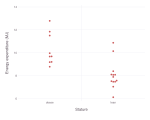

In [38]:
#| label: fig-fig27
#| fig-cap: "Comparison of energy expenditure between obese and lean women."
plot(
	energy,
	x = :stature, y = :expend,
	Geom.beeswarm,
	Guide.xlabel("Stature"),
	Guide.ylabel("Energy expenditure (MJ)"),
	Theme(default_color="IndianRed")
)

Umm, not perfect. In @fig-fig27, dots are plotted to the right side of the corresponding thick. An alternative is to use *rain clouds*: we show the distribution on the left side (e.g., a violin plot) and the observations on the right side (i.e., a strip chart).

In [39]:
energy_bst = pubh.gen_bst_df(@formula(expend ~ stature), data=energy) |> rcopy

Row,expend,LowerCI,UpperCI,stature
,Float64,Float64,Float64,Cat…
1,8.07,7.48,8.74,lean
2,10.3,9.5,11.24,obese


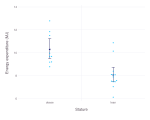

In [40]:
#| label: fig-fig28
#| fig-cap: "Comparison of energy expenditure between obese and lean women."
plot(
	layer(
		x=energy.stature, 
		y=energy.expend, 
		Geom.beeswarm, 
		size=fill(2px, nrow(energy))	
	),
	layer(
		x=energy_bst.stature, 
		y=energy_bst.expend,
		ymin=energy_bst.LowerCI, 
		ymax=energy_bst.UpperCI,
		Geom.point,
		Geom.errorbar,
		Theme(default_color="MidnightBlue")
	),
	Guide.xlabel("Stature"),
	Guide.ylabel("Energy expenditure (MJ)")
)

We can function `gen_bst_df` from `R` package `pubh` to generate a data frame with bootstrap confidence intervals around the mean, stratified by a categorical variable. With this data frame, then we can construct a strip chart with error bars as shown bellow.

::: callout-note
Most of the functions from `pubh` use formulas. The `@formula` macro is part of `GLM.jl` that we would need to load.
:::

### Violin Plots

Violin plots are an alternative to box-plots.

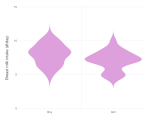

In [41]:
#| label: fig-fig30
#| fig-cap: "Comparison of breast-milk intake by sex."
plot(
	kfm,
	x = :sex, y = :dl_milk,
	Geom.violin,
	Guide.xlabel(""),
	Guide.ylabel("Breast milk intake (dl/day) "),
	Theme(default_color="Plum")
)

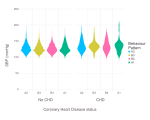

In [42]:
#| label: fig-fig31
#| fig-cap: "Comparison of systolic blood pressure (SBP) by coronary heart disease event and behaviour pattern group."
plot(
	wcgs,
	x = :beh_pat, y = :sbp, color = :beh_pat, xgroup=:chd,
	Geom.subplot_grid(Geom.violin),
	Guide.xlabel("Coronary Heart Disease status"),
	Guide.ylabel("SBP (mmHg)"),
	Guide.colorkey("Behaviour \n Pattern")
)

### Bar Charts

Bar charts or bar plots are used, most of the time, to display information from a table graphically. Therefore, for publications are not the best option as a table uses less space and contains better information.

**Frequency**

For categorical variables, we can plot the counts with `frequency`.

In [43]:
@combine(groupby(birth, [:race, :low]), :count = @nrow)

Row,race,low,count
,Cat…,Cat…,Int64
1,White,No,73
2,White,Yes,23
3,African-American,No,15
4,African-American,Yes,11
5,Other,No,42
6,Other,Yes,25


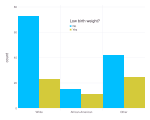

In [44]:
#| label: fig-fig33
#| fig-cap: "Comparison of low-birth babies by ethnicity."
plot(
	@combine(groupby(birth, [:race, :low]), :count = @nrow),
	x = :race, y = :count, color = :low,
	Geom.bar(position=:dodge),
	Guide.xlabel(""),
	Guide.colorkey(title="Low birth weight?", pos=[0.4w, -0.3h])
)

**Expectation**

For continuous variables, we can plot the expected (mean) values, with `expectation`.

In [45]:
pubh.gen_bst_df(@formula(dl_milk ~ sex), data=kfm) |> rcopy

Row,dl_milk,LowerCI,UpperCI,sex
,Float64,Float64,Float64,Cat…
1,7.95,7.35,8.52,Boy
2,7.06,6.51,7.61,Girl


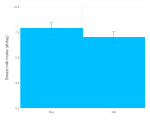

In [46]:
#| label: fig-fig34
#| fig-cap: "Comparison of birth weight by race and smoking status of the mother. Height of the bar represents mean values on each group."
plot(
	pubh.gen_bst_df(@formula(dl_milk ~ sex), data=kfm) |> rcopy,
	x = :sex, y = :dl_milk, ymin = :LowerCI, ymax = :UpperCI,
	Scale.x_discrete(levels=["Boy", "Girl"]),
	Geom.errorbar, Stat.dodge, Geom.bar(position = :dodge),
	Guide.xlabel(""),
	Guide.ylabel("Breast-milk intake (dl/day)")
)

In [48]:
fn1(x, u=mean(x), s=std(x)) = (bwt=u, ymin=u-s, ymax=u+s)
df = combine(groupby(birth, [:smoke, :Race]), :bwt=>fn1=>AsTable)

Row,smoke,Race,bwt,ymin,ymax
,Cat…,Cat…,Float64,Float64,Float64
1,Non-smoker,White,3428.75,2718.65,4138.85
2,Non-smoker,Non-white,2824.51,2138.11,3510.9
3,Smoker,White,2826.85,2200.37,3453.32
4,Smoker,Non-white,2642.09,1911.14,3373.04


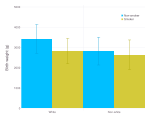

In [49]:
let
	fn1(x, u=mean(x), s=std(x)) = (bwt=u, ymin=u-s, ymax=u+s)
	df = combine(groupby(birth, [:smoke, :Race]), :bwt=>fn1=>AsTable)
	plot(
		df,
		x = :Race, y = :bwt, color = :smoke, ymin = :ymin, ymax = :ymax,
		Scale.x_discrete(levels=["White", "Non-white"]),
		Geom.errorbar, Stat.dodge, Geom.bar(position = :dodge),
		Guide.xlabel(""),
		Guide.ylabel("Birth weight (g)"),
		Guide.colorkey(title="", pos=[0.8w, -0.4h])
	)
end